# DESeq2_fromGeneCountsDF.ipynb
## Marcus Viscardi,    February 14, 2024

This notebook will use py2r to run DESeq2 on a gene counts dataframe and return the results as a pandas dataframe.

In large part this is going to be using methods from my `tryingToNotNeedSeperateRScript.ipynb` script in the `nano3P-seq_tails` directory. And using the DESeq calling from my BME237 final project, which can be found at: `/home/marcus/PycharmProjects/BME237/finalProject`

In [1]:
import rpy2.robjects as ro
from rpy2.robjects import pandas2ri
import pandas as pd
from pathlib import Path

import seaborn as sea
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go

import nanoporePipelineCommon as npCommon

from icecream import ic
from datetime import datetime

def __time_formatter__():
    now = datetime.now().strftime("%Y-%m-%d %H:%M:%S")
    return f"ic: {now} | > "
ic.configureOutput(prefix=__time_formatter__)


ic("Imports done.")
working_dir = Path.cwd()
_ = ic(working_dir)

ic: 2024-02-29 17:18:33 | > 'Imports done.'
ic: 2024-02-29 17:18:34 | > working_dir: PosixPath('/data16/marcus/scripts/nanoporePipelineScripts/DESeq2_fromGeneCounts')


In [2]:
gene_id_gene_name_df = npCommon.gene_names_to_gene_ids()
gene_id_gene_name_df.head()

,gene_name,gene_id,chr
0,cTel3X.2,WBGene00197333,V
1,cTel3X.3,WBGene00198386,V
2,B0348.5,WBGene00015153,V
3,ife-3,WBGene00002061,V
4,B0348.10,WBGene00255704,V


# Data formatting

First we need to wrangle the data into a format that DESeq will be okay with working on. The simplest setup is into a tsv with the following headers:
`Gene ID  |  Lib1  |  Lib2  |  Lib3  |  ...`
And rows for each gene

In [4]:
obj_dict = {}
libs_to_run = [
    # "oldN2",
    # "oldS6",
    "newerN2",
    # "newerS6",
    # "newerS5",
    # "thirdN2",
    # "thirdS5",
    # "thirdS6",
]
for lib in libs_to_run:
    print(f"\nLoading {lib}...", end="")
    obj_dict[lib] = npCommon.NanoporeRun(run_nickname=lib)
    print(" Done!")


Loading newerN2... Done!


In [5]:
compressedOnGenes_dict = {}
for lib, obj in obj_dict.items():
    compressedOnGenes_dict[lib] = obj.load_compressedOnGenes()  # Looks like the old N2 library had a read cutoff of 5 while everything else had no cutoff!!
    ic(obj)
read_hits_series_dict = {}
for lib, df in compressedOnGenes_dict.items():
    print(f"Pre-cutdown:  {lib} - {df.shape[0]:,} Genes", end=" ")
    # # TODO: Eventually, I should rerun the compressing for oldN2 without the cutoff!!!
    # df = df.query("read_hits >= 5")
    print(f"Post-cutdown: {lib} - {df.shape[0]:,} Genes")
    hits_series = df[['gene_id', 'read_hits']].set_index('gene_id')
    hits_series.rename(columns={'read_hits': lib}, inplace=True)
    read_hits_series_dict[lib] = hits_series
read_hits_table = pd.concat(read_hits_series_dict.values(), axis=1).fillna(0)
read_hits_table.to_csv(working_dir / 'read_hits.tsv', sep='\t')

Loading 230327_compressedOnGenes.parquet...

ic: 2024-02-20 11:40:07 | > obj: <nanoporePipelineCommon.NanoporeRun object at 0x7fd6e51fd610>


 Done. Loaded 12,714 rows.
Loading 230403_compressedOnGenes.parquet...

ic: 2024-02-20 11:40:08 | > obj: <nanoporePipelineCommon.NanoporeRun object at 0x7fd5ba7a8d10>


 Done. Loaded 13,438 rows.
Loading 230410_compressedOnGenes.parquet...

ic: 2024-02-20 11:40:08 | > obj: <nanoporePipelineCommon.NanoporeRun object at 0x7fd5b29177d0>


 Done. Loaded 12,407 rows.
Loading 230920_compressedOnGenes.parquet...

ic: 2024-02-20 11:40:10 | > obj: <nanoporePipelineCommon.NanoporeRun object at 0x7fd58e1f03d0>


 Done. Loaded 12,829 rows.
Loading 230920_compressedOnGenes.parquet...

ic: 2024-02-20 11:40:12 | > obj: <nanoporePipelineCommon.NanoporeRun object at 0x7fd51f06c090>


 Done. Loaded 13,742 rows.
Loading 230918_compressedOnGenes.parquet...

ic: 2024-02-20 11:40:12 | > obj: <nanoporePipelineCommon.NanoporeRun object at 0x7fd51f04c090>


 Done. Loaded 10,789 rows.
Pre-cutdown:  newerN2 - 12,714 Genes Post-cutdown: newerN2 - 12,714 Genes
Pre-cutdown:  newerS6 - 13,438 Genes Post-cutdown: newerS6 - 13,438 Genes
Pre-cutdown:  newerS5 - 12,407 Genes Post-cutdown: newerS5 - 12,407 Genes
Pre-cutdown:  thirdN2 - 12,829 Genes Post-cutdown: thirdN2 - 12,829 Genes
Pre-cutdown:  thirdS5 - 13,742 Genes Post-cutdown: thirdS5 - 13,742 Genes
Pre-cutdown:  thirdS6 - 10,789 Genes Post-cutdown: thirdS6 - 10,789 Genes


# Running DESeq2

In [6]:
# Build sample table:
sampleTable = pd.DataFrame({
    'sample': libs_to_run,
    'condition': [lib_title[-2:] for lib_title in libs_to_run],
    'batch': [lib_title[:-2] for lib_title in libs_to_run],
})
sampleTable.set_index('sample', inplace=True)
# sampleTable.to_csv(working_dir / 'sampleTable.csv')
sampleTable

,condition,batch
sample,,
newerN2,N2,newer
newerS6,S6,newer
newerS5,S5,newer
thirdN2,N2,third
thirdS5,S5,third
thirdS6,S6,third


In [7]:
def run_deseq2(read_hits_table__: pd.DataFrame, sample_table__: pd.DataFrame,
               design_str: str = "~ condition", save_name=None) -> pd.DataFrame:
    """
    
    :param read_hits_table__: 
    :param sample_table__: 
    :param design_str: 
    :param save_name: 
    :return: 
    """
    # Load the DESeq2 library
    ro.r('library(DESeq2)')
    
    # Some "magic" here where we take the pandas dataframe and convert it to an R dataframe inside the global environment
    pandas2ri.activate()
    # TODO: add some checks here to ensure that the sample_table index is the same as the read_hits_table columns
    ro.globalenv['gene_matrix'] = pandas2ri.py2rpy(read_hits_table__)
    ro.globalenv['sample_table'] = pandas2ri.py2rpy(sample_table__)
    
    # Create the DESeq2 object
    ro.r(f'dds <- DESeqDataSetFromMatrix(countData = gene_matrix, colData = sample_table, design = {design_str})')
    # Run the DESeq2 analysis
    ro.r('dds <- DESeq(dds)')
    # Get the results
    ro.r('res <- results(dds)')
    # Sort the results by padj
    ro.r('res <- res[order(res$padj),]')
    
    # Save the results to a csv file (if given)
    if save_name and Path(save_name).parent.exists() and save_name.endswith('.csv'):
        print(f"Saving results to {save_name}")
        ro.r(f'write.csv(as.data.frame(res), file="{save_name}")')
    elif save_name:
        print(f"Save name: {save_name} is not valid, must be a .csv file and the parent directory must exist.")
    
    # Another bit of "magic" to convert the R dataframe back to a pandas dataframe and return it
    return ro.pandas2ri.rpy2py(ro.r('as.data.frame(res)'))

In [8]:
comparisons = (
    ('N2', 'S5'),
    ('N2', 'S6'),
    # ('S5', 'S6'),
)
print(read_hits_table.head())

comparisons_res_dict = {}
for comparison in comparisons:
    print(f"\nRunning DESeq2 for {comparison[0]} vs {comparison[1]}")
    mini_sample_table = sampleTable.query(f"condition == '{comparison[0]}' | condition == '{comparison[1]}'")
    mini_read_hits_table = read_hits_table[mini_sample_table.index]
    # print(mini_sample_table)
    # print(mini_read_hits_table.head())
    comparisons_res_dict[comparison] = run_deseq2(mini_read_hits_table, mini_sample_table)
print("Done")

                newerN2  newerS6  newerS5  thirdN2  thirdS5  thirdS6
gene_id                                                             
WBGene00001168   5037.0   7803.0   3847.0   5592.0   6896.0   2033.0
WBGene00004409   3369.0   5371.0   2643.0   3627.0   4149.0   1811.0
WBGene00004494   3091.0   4966.0   2664.0   3511.0   4206.0   1567.0
WBGene00004408   3043.0   5093.0   2370.0   3154.0   3821.0   1664.0
WBGene00004492   3013.0   4644.0   2281.0   3194.0   3759.0   1555.0

Running DESeq2 for N2 vs S5


R[write to console]: Loading required package: S4Vectors

R[write to console]: Loading required package: stats4

R[write to console]: Loading required package: BiocGenerics

R[write to console]: 
Attaching package: ‘BiocGenerics’


R[write to console]: The following objects are masked from ‘package:stats’:

    IQR, mad, sd, var, xtabs


R[write to console]: The following objects are masked from ‘package:base’:

    anyDuplicated, aperm, append, as.data.frame, basename, cbind,
    colnames, dirname, do.call, duplicated, eval, evalq, Filter, Find,
    get, grep, grepl, intersect, is.unsorted, lapply, Map, mapply,
    match, mget, order, paste, pmax, pmax.int, pmin, pmin.int,
    Position, rank, rbind, Reduce, rownames, sapply, setdiff, sort,
    table, tapply, union, unique, unsplit, which.max, which.min


R[write to console]: 
Attaching package: ‘S4Vectors’


R[write to console]: The following object is masked from ‘package:utils’:

    findMatches


R[write to console]: The following 


Running DESeq2 for N2 vs S6


R[write to console]: In addition: 
R[write to console]: Warning message:

R[write to console]: In DESeqDataSet(se, design = design, ignoreRank) :
R[write to console]: 
 
R[write to console]:  some variables in design formula are characters, converting to factors

R[write to console]: estimating size factors

R[write to console]: estimating dispersions

R[write to console]: gene-wise dispersion estimates

R[write to console]: mean-dispersion relationship

R[write to console]: final dispersion estimates

R[write to console]: fitting model and testing



Done


In [9]:
for comparison, res_df in comparisons_res_dict.items():
    print(f"\n{comparison[0]} vs {comparison[1]}")
    assert isinstance(res_df, pd.DataFrame), f"res_df is not a pandas dataframe, it is a {type(res_df)}"
    print(res_df.head(-5))
    break


N2 vs S5
                  baseMean  log2FoldChange     lfcSE      stat        pvalue      padj
WBGene00022219  627.273980        1.857534  0.298009  6.233139  4.571804e-10  0.000003
WBGene00003844  608.758496        1.828555  0.303772  6.019507  1.749487e-09  0.000004
WBGene00022951  374.147900        1.982342  0.332662  5.959026  2.537464e-09  0.000004
WBGene00016662  120.373982        2.548287  0.429019  5.939795  2.853781e-09  0.000004
WBGene00012680  152.621685        2.290157  0.388262  5.898489  3.668445e-09  0.000004
...                    ...             ...       ...       ...           ...       ...
WBGene00016056    0.000000             NaN       NaN       NaN           NaN       NaN
WBGene00016168    0.000000             NaN       NaN       NaN           NaN       NaN
WBGene00015700    0.000000             NaN       NaN       NaN           NaN       NaN
WBGene00015753    0.000000             NaN       NaN       NaN           NaN       NaN
WBGene00013652    0.000000       

In [10]:
import numpy as np
res_df['-log2(padj)'] = -1 * res_df['padj'].apply(np.log2)
res_df['-log10(padj)'] = -1 * res_df['padj'].apply(np.log10)

In [11]:
fig = px.scatter(res_df,
           x='log2FoldChange',
           y='-log2(padj)',
           hover_name=res_df.index)
fig.update_layout(
    yaxis_title='-log<sub>2</sub>(padj)',
    xaxis_title='log<sub>2</sub>(Fold Change)',
    # title=f'<b>Read depth vs. Protein Coding</b><br>Subsamples per point: {number_of_subsamples_per_step}',
    template="plotly_white",
    width=500, height=500,
)

In [12]:
for comparison, res_df in comparisons_res_dict.items():
    res_df['-log2(padj)'] = -1 * res_df['padj'].apply(np.log2)
    res_df['-log10(padj)'] = -1 * res_df['padj'].apply(np.log10)
    
concat_res_df = pd.concat(comparisons_res_dict.values(), axis=1, keys=[f"{comparison[0]} vs {comparison[1]}" for comparison in comparisons])

for comparison in comparisons:
    comp_key = f"{comparison[0]} vs {comparison[1]}"
    print(comp_key)
    assert '-log2(padj)' in concat_res_df[comp_key].columns, f"'-log2(padj)' not in {comp_key} columns; columns are: {concat_res_df[comp_key].columns}"
    fig = px.scatter(concat_res_df[comp_key],
               x='log2FoldChange',
               y='-log2(padj)',
               hover_name=concat_res_df[comp_key].index)
    fig.update_layout(
        yaxis_title='-log<sub>2</sub>(padj)',
        xaxis_title='log<sub>2</sub>(Fold Change)',
        title=f'<b>{comp_key}</b>',
        template="plotly_white",
        width=500, height=500,
    )
    fig.show()

N2 vs S5


N2 vs S6


In [13]:
# Let's plot N2vS5 -log2(padj) vs N2vS6 -log2(padj)
plot_df = concat_res_df.copy()
plot_df.columns = [' '.join(col).strip() for col in plot_df.columns.values]
fig = px.scatter(plot_df,
           x=f"N2 vs S5 -log2(padj)",
           y=f"N2 vs S6 -log2(padj)",
           hover_name=concat_res_df.index)
fig.update_layout(
    yaxis_title='N2 vs S6 -log<sub>2</sub>(padj)',
    xaxis_title='N2 vs S5 -log<sub>2</sub>(padj)',
    title=f'<b>N2 vs S5 vs N2 vs S6</b>',
    template="plotly_white",
    width=500, height=500,
)
fig.show()

In [14]:
plot_df = concat_res_df.copy()
plot_df.columns = [' '.join(col).strip() for col in plot_df.columns.values]
fig = px.scatter(plot_df,
           x=f"N2 vs S5 log2FoldChange",
           y=f"N2 vs S6 log2FoldChange",
           hover_name=concat_res_df.index)
fig.update_layout(
    yaxis_title='N2 vs S6 log<sub>2</sub> Fold Change',
    xaxis_title='N2 vs S5 log<sub>2</sub> Fold Change',
    title=f'<b>N2 vs S5 vs N2 vs S6</b>',
    template="plotly_white",
    width=500, height=500,
)
fig.show()

In [16]:
# Load up Fishers results:
fishers_parquet_path = Path('/home/marcus/Insync/mviscard@ucsc.edu/Google Drive/insync_folder/NMD_cleavage_and_deadenylation_paper/raw_figures_from_python/240214_fishers/240214_newerN2-newerS5-newerS6-thirdN2-thirdS5-thirdS6_fishersPvalues-v-FCfractionAdapted.scatters.parquet')
fishers_df = pd.read_parquet(fishers_parquet_path)
columns_to_keep = ['gene_id', 'gene_name']
columns_to_keep += [col for col in fishers_df.columns if 'significant' in col or 'p_value' in col]
fishers_df = fishers_df[columns_to_keep]
fishers_df

oldN2_v_oldS6_fishers_significant
oldN2_v_oldS6_fishers_significant
False    16720
True        23
Name: count, dtype: int64
newerN2_v_newerS6_fishers_significant
newerN2_v_newerS6_fishers_significant
False    16717
True        26
Name: count, dtype: int64
newerN2_v_newerS5_fishers_significant
newerN2_v_newerS5_fishers_significant
False    16728
True        15
Name: count, dtype: int64
thirdN2_v_thirdS6_fishers_significant
thirdN2_v_thirdS6_fishers_significant
False    16716
True        27
Name: count, dtype: int64
thirdN2_v_thirdS5_fishers_significant
thirdN2_v_thirdS5_fishers_significant
False    16716
True        27
Name: count, dtype: int64


In [29]:
batch_to_use = 'newer'

fishers_dfs_dict = {}
for comparison in comparisons:
    # We need to create columns of significance for each comparison - because there are two libs we will just say True if either are True
    comp_key = f"{comparison[0]} vs {comparison[1]}"
    print(comp_key)
    sig_cols = [col for col in fishers_df.columns if comparison[1] in col and 'significant' in col and 'oldS6' not in col]
    keep_cols = ['gene_id', 'gene_name'] + sig_cols
    comp_df = fishers_df[keep_cols]
    # comp_df[f'{comp_key} significant'] = comp_df[sig_cols].any(axis=1)
    
    batch_fishers_col = f"{batch_to_use}{comparison[0]}_v_{batch_to_use}{comparison[1]}_fishers_significant"
    try:
        comp_df[f'{comp_key} significant'] = comp_df[batch_fishers_col]
    except KeyError:
        ic(batch_fishers_col)
        ic('newerN2_v_newerS5_fishers_significant' == batch_fishers_col)
        print(batch_fishers_col in comp_df.columns)
        ic(comp_df.columns)
        raise KeyError(f"Could not find {batch_to_use}{comparison[0]}_v_{batch_to_use}{comparison[1]}_fishers_significant in columns: {comp_df.columns}")
    
    comp_df[f'{comp_key} significant'] = comp_df[f'{comp_key} significant'].fillna(False)
    # print(comp_df.sort_values(f'{comp_key} significant', ascending=False).head())
    fishers_dfs_dict[comp_key] = comp_df
    for col in sig_cols:
        print(comp_df[col].value_counts())
    print(comp_df[f'{comp_key} significant'].value_counts())

N2 vs S5
newerN2_v_newerS5_fishers_significant
False    16728
True        15
Name: count, dtype: int64
thirdN2_v_thirdS5_fishers_significant
False    16716
True        27
Name: count, dtype: int64
N2 vs S5 significant
False    16728
True        15
Name: count, dtype: int64
N2 vs S6
newerN2_v_newerS6_fishers_significant
False    16717
True        26
Name: count, dtype: int64
thirdN2_v_thirdS6_fishers_significant
False    16716
True        27
Name: count, dtype: int64
N2 vs S6 significant
False    16717
True        26
Name: count, dtype: int64


/tmp/ipykernel_171316/1532296101.py:15: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_171316/1532296101.py:23: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_171316/1532296101.py:15: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipyke

In [30]:
 # TODO: Next up is making the MAPlots that Josh wanted!
# Y-axis: log2(lib1/lib2)
# X-axis: average expression - which we will calculate as the average counts for each gene across all samples
# Color: based on significance of the padj values over some cutoff!
padj_cutoff = 0.05
# First we need to calculate the average expression
# This will require pulling back information from the compressedOnGenes dataframes
for comparison in comparisons:
    comp_key = f"{comparison[0]} vs {comparison[1]}"
    # print(comp_key)
    res_df = concat_res_df[comp_key]
    res_df['significant'] = res_df['padj'] <= padj_cutoff
    # print(res_df.head())
    read_hit_df = read_hits_table[[col for col in read_hits_table.columns if comparison[0] in col or comparison[1] in col]]
    read_hit_df['avg'] = read_hit_df.mean(axis=1)
    read_hit_df['log10avg'] = read_hit_df['avg'].apply(np.log10)
    res_extra_df = res_df.join(read_hit_df)
    # Let's drop cerENO2 from the table (this is in the index)
    res_extra_df = res_extra_df.loc[~res_extra_df.index.str.contains('cerENO2')]
    
    # Let's add gene names
    res_extra_df.reset_index(names='gene_id', inplace=True)
    res_extra_df = res_extra_df.merge(gene_id_gene_name_df, on='gene_id', how='left')
    
    # Let's add fishers results
    fishers_df = fishers_dfs_dict[comp_key]
    res_extra_df = res_extra_df.merge(fishers_df, on=['gene_id', 'gene_name'], how='left')
    
    res_extra_df[f'{comp_key} significant'] = res_extra_df[f'{comp_key} significant'].fillna(False)
    
    res_extra_df[f'{comp_key} significant to_size'] = res_extra_df[f'{comp_key} significant'].apply(lambda x: 3 if x else 0.5)
    
    drop_gene_names = ['cerENO2', 'F23A7.4', 'F23A7.8']
    drop_chrs = ['MtDNA']
    res_extra_df = res_extra_df[~res_extra_df['gene_name'].isin(drop_gene_names)]
    res_extra_df = res_extra_df[~res_extra_df['chr'].isin(drop_chrs)]
    
    
    # print(res_extra_df.head())
    fig = px.scatter(res_extra_df,
                     x=f"avg",
                     log_x=True,
                     y=f"log2FoldChange",
                     color='significant',
                     symbol=f'{comp_key} significant',
                     symbol_map={True: 'cross', False: 'circle'},
                     size=f'{comp_key} significant to_size',
                     opacity=1.0,
                     color_discrete_map={True: 'red', False: 'black'},
                     hover_name='gene_name',
                     hover_data=['gene_id', 'log10avg', 'log2FoldChange', 'padj', f'{comp_key} significant'],
                     )
    fig.update_traces(marker=dict(line=dict(width=0.5,
                                            color='black')),
                      selector=dict(mode='markers'))
    fig.update_layout(
                      yaxis_title='log<sub>2</sub>(Fold Change)',
                      xaxis_title='Average Expression',
                      title=f'<b>{comp_key}</b>',
                      template="plotly_white",
                      # width=750, height=500,
    )
    fig.write_html(working_dir / f'{comp_key}_MAPlot.html')
    fig.show()

# Then we can make the MAPlots

/tmp/ipykernel_171316/3485368858.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_171316/3485368858.py:15: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_171316/3485368858.py:29: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`



/tmp/ipykernel_171316/3485368858.py:12: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_171316/3485368858.py:15: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_171316/3485368858.py:29: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`



/tmp/ipykernel_171316/1355247552.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_171316/1355247552.py:16: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_171316/1355247552.py:27: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`



Index(['gene_id', 'baseMean', 'log2FoldChange', 'lfcSE', 'stat', 'pvalue', 'padj', '-log2(padj)',
       '-log10(padj)', 'significant', 'newerN2', 'newerS5', 'thirdN2', 'thirdS5', 'avg',
       'log10avg', 'gene_name', 'chr', 'newerN2_v_newerS5_fishers_significant',
       'thirdN2_v_thirdS5_fishers_significant', 'N2 vs S5 significant',
       'N2 vs S5 significant to_size'],
      dtype='object')
significant  newerN2_v_newerS5_fishers_significant
False        False                                    16284
True         False                                       51
False        True                                         8
True         True                                         7
Name: count, dtype: int64


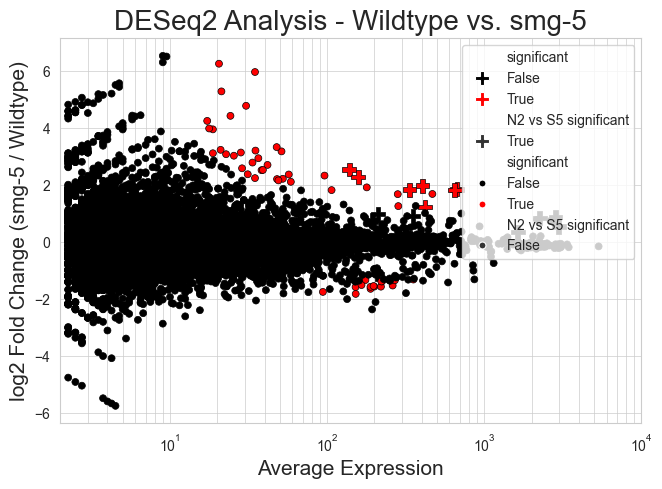

/tmp/ipykernel_171316/1355247552.py:14: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_171316/1355247552.py:16: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/tmp/ipykernel_171316/1355247552.py:27: FutureWarning:

Downcasting object dtype arrays on .fillna, .ffill, .bfill is deprecated and will change in a future version. Call result.infer_objects(copy=False) instead. To opt-in to the future behavior, set `pd.set_option('future.no_silent_downcasting', True)`



Index(['gene_id', 'baseMean', 'log2FoldChange', 'lfcSE', 'stat', 'pvalue', 'padj', '-log2(padj)',
       '-log10(padj)', 'significant', 'newerN2', 'newerS6', 'thirdN2', 'thirdS6', 'avg',
       'log10avg', 'gene_name', 'chr', 'newerN2_v_newerS6_fishers_significant',
       'thirdN2_v_thirdS6_fishers_significant', 'N2 vs S6 significant',
       'N2 vs S6 significant to_size'],
      dtype='object')
significant  newerN2_v_newerS6_fishers_significant
False        False                                    16245
True         False                                       79
False        True                                        16
True         True                                        10
Name: count, dtype: int64


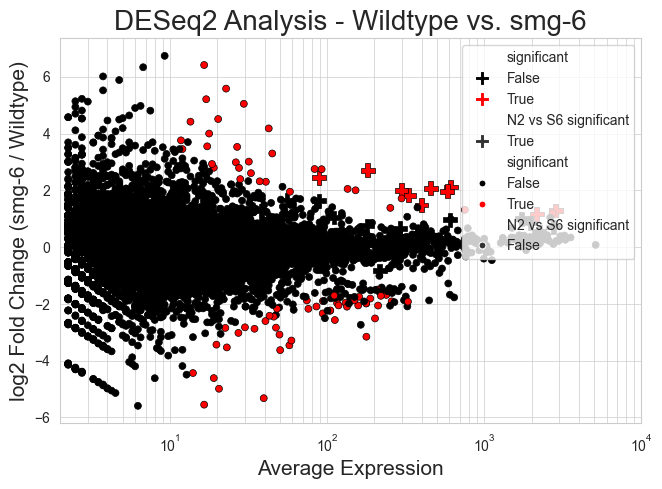

In [40]:
import pandas as pd
import plotly.express as px
import matplotlib.pyplot as plt
import seaborn as sns
import numpy as np
import pandas as pd
from pathlib import Path

def process_data_for_MAPlot(comparison: tuple, concat_res_df: pd.DataFrame, read_hits_table: pd.DataFrame, 
                            gene_id_gene_name_df: pd.DataFrame, fishers_dfs_dict: dict,
                            padj_cutoff: float = 0.05):
    comp_key = f"{comparison[0]} vs {comparison[1]}"
    res_df = concat_res_df[comp_key]
    res_df['significant'] = res_df['padj'] <= padj_cutoff
    read_hit_df = read_hits_table[[col for col in read_hits_table.columns if comparison[0] in col or comparison[1] in col]]
    read_hit_df['avg'] = read_hit_df.mean(axis=1)
    read_hit_df['log10avg'] = read_hit_df['avg'].apply(np.log10)
    res_extra_df = res_df.join(read_hit_df)
    res_extra_df = res_extra_df.loc[~res_extra_df.index.str.contains('cerENO2')]

    res_extra_df.reset_index(names='gene_id', inplace=True)
    res_extra_df = res_extra_df.merge(gene_id_gene_name_df, on='gene_id', how='left')

    fishers_df = fishers_dfs_dict[comp_key]
    res_extra_df = res_extra_df.merge(fishers_df, on=['gene_id', 'gene_name'], how='left')

    res_extra_df[f'{comp_key} significant'] = res_extra_df[f'{comp_key} significant'].fillna(False)

    res_extra_df[f'{comp_key} significant to_size'] = res_extra_df[f'{comp_key} significant'].apply(lambda x: 3 if x else 0.5)

    drop_gene_names = ['cerENO2', 'F23A7.4', 'F23A7.8']
    drop_chrs = ['MtDNA']
    res_extra_df = res_extra_df[~res_extra_df['gene_name'].isin(drop_gene_names)]
    res_extra_df = res_extra_df[~res_extra_df['chr'].isin(drop_chrs)]

    return res_extra_df

def create_MAPlot_plotly(res_extra_df: pd.DataFrame, comparison: tuple,
                         working_dir: Path, show=True, save_name=None):
    comp_key = f"{comparison[0]} vs {comparison[1]}"
    fig = px.scatter(res_extra_df,
                     x=f"avg",
                     log_x=True,
                     y=f"log2FoldChange",
                     color='significant',
                     symbol=f'{comp_key} significant',
                     symbol_map={True: 'cross', False: 'circle'},
                     size=f'{comp_key} significant to_size',
                     opacity=1.0,
                     color_discrete_map={True: 'red', False: 'black'},
                     hover_name='gene_name',
                     hover_data=['gene_id', 'log10avg', 'log2FoldChange', 'padj', f'{comp_key} significant'],
                     )
    fig.update_traces(marker=dict(line=dict(width=0.5,
                                            color='black')),
                      selector=dict(mode='markers'))
    fig.update_layout(
                      yaxis_title='log<sub>2</sub>(Fold Change)',
                      xaxis_title='Average Expression',
                      title=f'<b>{comp_key}</b>',
                      template="plotly_white",
    )
    if save_name:
        save_name = save_name.rstrip('.html').rstrip('.svg').rstrip('.png')
        fig.write_html(working_dir / (save_name + '.html'))
    if show:
        fig.show()

def create_MAPlot_seaborn(res_extra_df: pd.DataFrame, comparison: tuple,
                          working_dir: Path, min_avg_cutoff: int = 1, show=True, save_name=None):
    conversion_dict = {'N2': 'Wildtype',
                       'S5': 'smg-5',
                       'S6': 'smg-6'}
    title1 = conversion_dict[comparison[0]]
    title2 = conversion_dict[comparison[1]]
    comp_key = f"{comparison[0]} vs {comparison[1]}"
    point_size = 10
    res_extra_df[f'{comp_key} significant to_size'] = res_extra_df[f'{comp_key} significant'].apply(lambda x: point_size if x else point_size)
    res_extra_df = res_extra_df.loc[res_extra_df['avg'] > min_avg_cutoff]
    sea.set_style('whitegrid')
    plt.figure(figsize=(7.5, 5))
    g = sea.scatterplot(data=res_extra_df[res_extra_df[f'{comp_key} significant']],
                        x='avg',
                        y='log2FoldChange',
                        hue='significant',
                        style=f'{comp_key} significant',
                        markers={True: 'P', False: '.'},
                        s=100,
                        palette={True: 'red', False: 'black'})
    plt.setp(g.collections, linewidth=0.5, edgecolor='black')
    g = sea.scatterplot(data=res_extra_df[~res_extra_df[f'{comp_key} significant']],
                        x='avg',
                        y='log2FoldChange',
                        hue='significant',
                        style=f'{comp_key} significant',
                        markers={True: 'P', False: '.'},
                        s=100,
                        palette={True: 'red', False: 'black'})
    plt.setp(g.collections, linewidth=0.5, edgecolor='black')
    plt.xscale('log')
    plt.xlim(min_avg_cutoff, 1e4)
    plt.grid(True, which='both', linewidth=0.5)
    plt.title(f'DESeq2 Analysis - {title1} vs. {title2}', fontsize=20)
    plt.xlabel('Average Expression', fontsize=15)
    plt.ylabel(f'log2 Fold Change ({title2} / {title1})', fontsize=15)
    if save_name:
        save_name = save_name.rstrip('.png').rstrip('.svg')
        plt.savefig(working_dir / (save_name + '.png'))
        plt.savefig(working_dir / (save_name + '.svg'))
    if show:
        plt.show()

for comparison in comparisons:
    save_name = f'{comparison[0]}_vs_{comparison[1]}_MAPlot.fishersFrom{batch_to_use.title()}'
    res_extra_df = process_data_for_MAPlot(comparison, concat_res_df,
                                           read_hits_table, gene_id_gene_name_df,
                                           fishers_dfs_dict, padj_cutoff)
    # print(res_extra_df.value_counts('newerN2 vs newerS5 significant'))
    print(res_extra_df.columns)
    print(res_extra_df.value_counts(['significant', f'newerN2_v_newer{comparison[1]}_fishers_significant']))
    create_MAPlot_plotly(res_extra_df, comparison, working_dir,
                         show=False, save_name=save_name)
    create_MAPlot_seaborn(res_extra_df, comparison, working_dir, min_avg_cutoff=2,
                          show=True, save_name=save_name)

In [34]:
fishers_dfs_dict

{'N2 vs S5':               gene_id   gene_name  newerN2_v_newerS5_fishers_significant  \
 0      WBGene00000013       abf-2                                  False   
 1      WBGene00000138       amx-2                                  False   
 2      WBGene00000140       anc-1                                  False   
 3      WBGene00000150       apm-1                                  False   
 4      WBGene00000158       apg-1                                  False   
 ...               ...         ...                                    ...   
 16753  WBGene00173542   21ur-7915                                  False   
 16754  WBGene00174909  21ur-14059                                  False   
 16755  WBGene00199316      PDB1.2                                  False   
 16756  WBGene00206484    C31H2.14                                  False   
 16757  WBGene00235152    Y7A5A.22                                  False   
 
        thirdN2_v_thirdS5_fishers_significant  N2 vs S5 signif